<a href="https://colab.research.google.com/github/ShineySun/Vision/blob/master/Face_Recognition_Edit.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

----
## ■ **Install Face Recognition Library**
----
### 1. **'face_recognition'** package
#### You can refer to the source code in this [face_recognition code repository](https://github.com/ageitgey/face_recognition)
----
### 2, **'FER(Facial Expression Recognition)'** package
#### You can refer to the source code in this [FER code repository](https://github.com/justinshenk/fer)
----


In [ ]:
!pip install -q face_recognition
!pip install -q fer
!python --version

     |████████████████████████████████| 100.2MB 42kB/s 
     |████████████████████████████████| 819kB 10.0MB/s 
     |████████████████████████████████| 2.3MB 34.6MB/s 
Python 3.7.10


----
## ■ **Import library for face recognition & image processing**
----
### 1. **'matplotlib'** package
#### Matplotlib is a comprehensive library for creating static, animated, and interactive visualizations in Python.
#### You can refer to the source code in this [matplotlib code repository](https://github.com/matplotlib/matplotlib)
----
### 2. **'Numpy'** package
#### NumPy offers comprehensive mathematical functions, random number generators, linear algebra routines, Fourier transforms, and more.
#### You can refer to the source code in this [numpy code repository](https://github.com/numpy/numpy)
----
### 3. **'Opencv'** package
#### Open Source Computer Vision Library
#### You can refer to the source code in this [opencv code repository](https://github.com/opencv/opencv)
----


In [ ]:
# import matplotlib modules
import matplotlib.pyplot as plt
from matplotlib.pyplot import imshow
import matplotlib.patches as patches
%matplotlib inline

# import image processing & Numerical Calculation libraries
import numpy as np
from PIL import ImageDraw
import PIL.Image
from io import BytesIO
import cv2

# import face detection algorithm libraries
from fer import FER
import face_recognition

# import necessary libraries
import operator
import time
from google.colab import files
from google.colab.patches import cv2_imshow

Instructions for updating:
non-resource variables are not supported in the long term


----
## ■ **Upload the Image with face**
----
### Step 1. **Download the Reference Image**
#### You can download the reference image in this [reference image download](https://unsplash.com/photos/1qfy-jDc_jo)
----
### Step 2. **Upload the Image**
#### Execute the next session and you have to upload the image you downloaded
----

In [ ]:
#@title **Upload image with faces**
uploaded = files.upload() #https://unsplash.com/photos/1qfy-jDc_jo

Saving omar-lopez-1qfy-jDc_jo-unsplash.jpg to omar-lopez-1qfy-jDc_jo-unsplash.jpg


----
## ■ **Display the Image with face**
----
### Step 1. **Allocate the image array**
```python
# get image name
image_name = list(uploaded.keys())[0]

# im : image array
im = PIL.Image.open(image_name)
```
----
### Step 2. **Upload the Image**
#### Set the width & height you want
```python
# set image width, height you want
width = 20
height = (im.size[1] / im.size[0]) * width
print("* Width, Height : {} , {}".format(width, height))
```
----
### Step 3. **Visualize the Image**
#### Visualize the image using **imshow** module of matplotlib.pyplot
```python
# visualize image
fig=plt.subplots(figsize=(width,height))
plt.title("Original Image")
imshow(im)
```
----

* Width, Height : 20 , 12.669753086419753


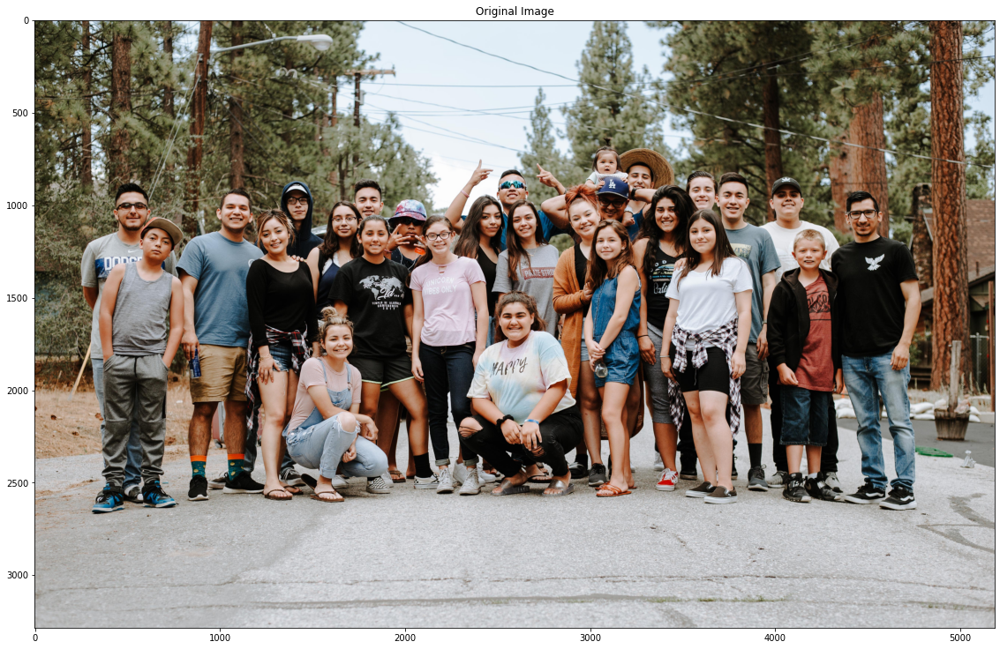

In [ ]:
#@title **Display image**
# get image name
image_name = list(uploaded.keys())[0]

# im : image array
im = PIL.Image.open(image_name)

# set image width, height
width = 20
height = (im.size[1] / im.size[0]) * width
print("* Width, Height : {} , {}".format(width, height))

# visualize image
fig=plt.subplots(figsize=(width,height))
plt.title("Original Image")
imshow(im)

----
## ■ **Use 'Face Recognition' library and draw a Red box around the faces**
----
### Step 1. **Loads an image file (.jpg, .png, etc) into a numpy array**
```python
# Loads an image file (.jpg, .png, etc) into a numpy array
image = face_recognition.load_image_file(image_name, mode='RGB')
```
----
### Step 2. **Detect faces in image**
#### Returns an array of bounding boxes of human faces in a image
```python
# Returns an array of bounding boxes of human faces in a image
# Parameter mode : ('hog', 'cnn')
face_locations = face_recognition.face_locations(image, model='hog')
```
----
### Step 3. **Visualize bounding boxes**
#### Visualize bounding boxes using **Rectangle** module of matplotlib.pyplot
```python
# Visualize bounding boxes
fig,ax = plt.subplots(figsize=(width,height))
plt.title("Face_recognition Image")

for face_location in face_locations:
  top, right, bottom, left = face_location
  ax.imshow(im,aspect='auto')
  rect = patches.Rectangle((left,top), (right - left), (bottom-top),linewidth=3,edgecolor='r',facecolor='none')
  ax.add_patch(rect)
```
----

* Number of faces : 24
* Time taken : 20.1  seconds


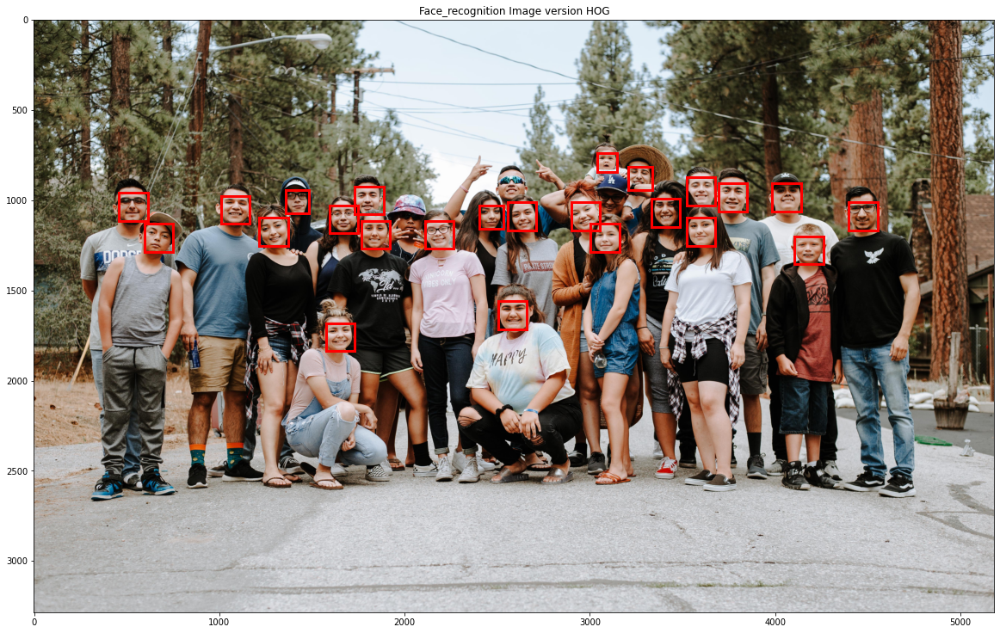

In [ ]:
#@title **Use 'Face Recognition' library and draw a red box around the faces**
start = time.time()

# Loads an image file (.jpg, .png, etc) into a numpy array
image = face_recognition.load_image_file(image_name, mode='RGB')

# Returns an array of bounding boxes of human faces in a image
# mode ('hog', 'cnn')
face_locations = face_recognition.face_locations(image, model='hog')

# Visualize bounding boxes
fig,ax = plt.subplots(figsize=(width,height))
plt.title("Face_recognition Image version HOG")

for face_location in face_locations:
  top, right, bottom, left = face_location
  ax.imshow(im,aspect='auto')
  # patches.Rectangle(xy, width, height)
  rect = patches.Rectangle((left,top), (right - left), (bottom-top),linewidth=3, edgecolor='r',facecolor='none')
  ax.add_patch(rect)

end = time.time()

print("* Number of faces : {}".format(len(face_locations)))
print("* Time taken :",round(end-start,2)," seconds")

----
## ■ **Use 'Face Recognition' library and draw a red box around the faces as well as predicted emotion using FER()**
----
### Step 1. **Construct the Facial Expression Recognition class**
```python
# Construct FER class
detector = FER()
```
----
### Step 2. **Detect faces in image**
#### Returns an array of bounding boxes of human faces in a image
```python
# Returns an array of bounding boxes of human faces in a image
# Parameter mode : ('hog', 'cnn')
face_locations = face_recognition.face_locations(image, model='hog')
```
----
### Step 3. **Visualize bounding boxes**
#### Visualize bounding boxes using **Rectangle** module of matplotlib.pyplot
```python
# Visualize bounding boxes
fig,ax = plt.subplots(figsize=(width,height))
plt.title("Face_recognition Image")

for face_location in face_locations:
  top, right, bottom, left = face_location
  ax.imshow(im,aspect='auto')
  rect = patches.Rectangle((left,top), (right - left), (bottom-top),linewidth=3,edgecolor='r',facecolor='none')
  ax.add_patch(rect)
```
----
### Step 4. **Predict the emotion from the cropped face image**
#### Predict & Visualize the image from the cropped image 
```python
    #======================================Emotion Detection=======================================#
    # Crop the current face
    face_image = image[top-boundary:bottom+boundary, left-boundary:right+boundary]
    
    # Detect the emotion from croped image
    attribute = detector.detect_emotions(face_image)
   
    # Visualize the emotion
    if (not attribute) == False:
      emotion = max(attribute[0]['emotions'].items(),key=operator.itemgetter(1))[0]
      #print(emotion)
      plt.text(left, top, emotion, fontsize=8, bbox=dict(fill=True, edgecolor='blue', linewidth=1))
    #================================================================================================#
```
----

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:2325: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  warnings.warn('`Model.state_updates` will be removed in a future version. '


* Number of faces : 24
* Time taken :  48.93041706085205  seconds


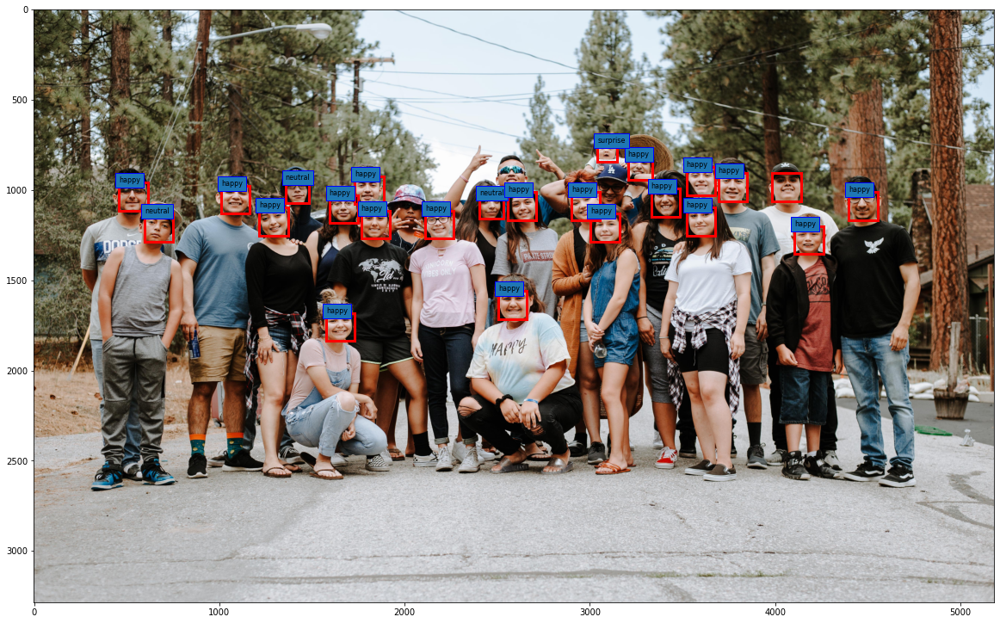

In [ ]:
#@title **Use 'Face Recognition' library and draw a red box around the faces as well as predicted emotion using FER()**

# Construct FER class
detector = FER()

boundary = 24
start = time.time()

# Returns an array of bounding boxes of human faces in a image
# mode ('hog', 'cnn')
face_locations = face_recognition.face_locations(image, model='hog')

# Visualize bounding boxes & predict emotion using FER
fig,ax = plt.subplots(figsize=(20,height))
for face_location in face_locations:
    top, right, bottom, left = face_location
    ax.imshow(im,aspect='auto')
    # patches.Rectangle(xy, width, height)
    rect = patches.Rectangle((left,top), (right - left), (bottom-top),linewidth=3,edgecolor='r',facecolor='none')
    ax.add_patch(rect)
    #======================================Emotion Detection=======================================#
    # Crop the current face
    face_image = image[top-boundary:bottom+boundary, left-boundary:right+boundary]
    
    # Detect the emotion from croped image
    attribute = detector.detect_emotions(face_image)
   
    # Visualize the emotion
    if (not attribute) == False:
      emotion = max(attribute[0]['emotions'].items(),key=operator.itemgetter(1))[0]
      #print(emotion)
      plt.text(left, top, emotion, fontsize=8, bbox=dict(fill=True, edgecolor='blue', linewidth=1))
    #================================================================================================#

end = time.time()
print("* Number of faces : {}".format(len(face_locations)))
print("* Time taken : ", end-start," seconds")

----
## ■ **Use Haar Cascades and draw a red box around the faces**
----
### Step 1. **Construct the Haar CascadeClassifier class**
```python
# Load the Haar cascades
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
```
----
### Step 2. **Load the image & Convert to gray image**
```python
# Load the input image
img = cv2.imread(image_name)

# Convert RGB Image into GrayScale Image
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
```
----
### Step 3. **Detect Faces in the image & Draw bounding boxes**
#### **scaleFactor** : Parameter specifying how much the image size is reduced at each image scale.
#### **minNeighbor** : Parameter specifying how many neighbors each candidate rectangle should have to retain it.
#### Visualize bounding boxes using **rectangle** module of cv2
```python
# Detect Faces in the image
faces = face_cascade.detectMultiScale(gray, scaleFactor=1.3, minNeighbors=4)

#Draw rectangle around each faces
for (x, y, w, h) in faces:
    cv2.rectangle(img, (x, y), (x + w, y + h), (0, 0, 255), 3)
```
----

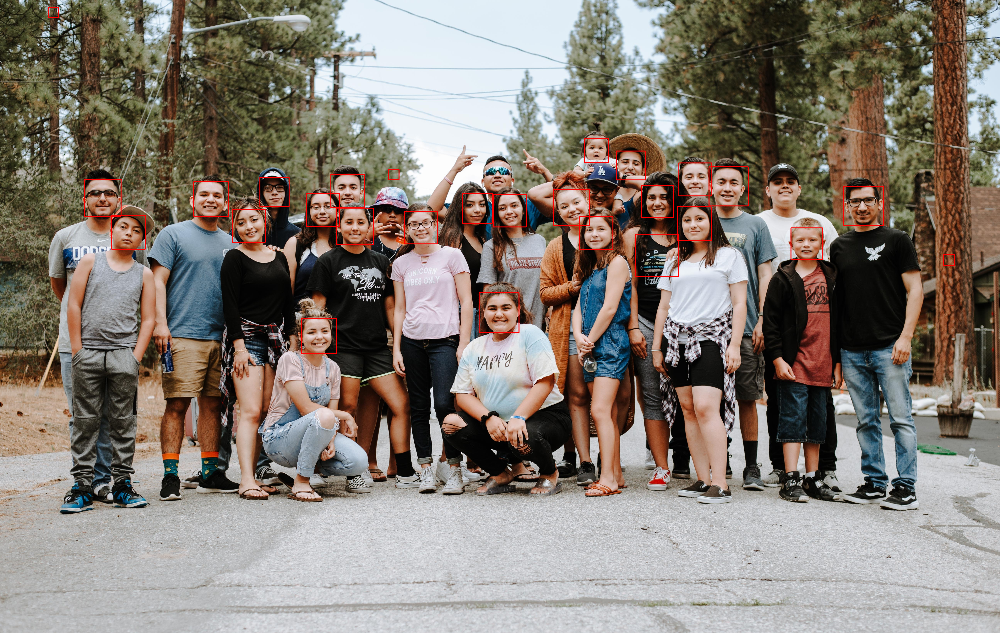

Time taken: 12.842216491699219  seconds
Number of faces: 27


In [ ]:
#@title **Use Haar Cascades and draw a red box around the faces**
start = time.time()

# Load the Haar cascades
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

# Load the input image
img = cv2.imread(image_name)

# Convert RGB Image into GrayScale Image
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Detect Faces in the image
faces = face_cascade.detectMultiScale(gray, scaleFactor=1.3, minNeighbors=4)

#Draw rectangle around each faces
for (x, y, w, h) in faces:
    cv2.rectangle(img, (x, y), (x + w, y + h), (0, 0, 255), 3)

#Display the output
ims = cv2.resize(img,(im.size[0],im.size[1]))
cv2_imshow(ims)
cv2.waitKey()

end = time.time()
print("Time taken:",end-start," seconds")
print("Number of faces:",len(faces))